## **Knaive Approach**

### * In this we are suppose to predict whether the test images are hiding some information or not but we dont have labels for the train images we just clean images and same images encoded using different algos, the main point is creating labels then we can approach this as regression problem. Since in steganography in images, any technique involves changes in pixel values, a very knaive way to get labels would be to flatten the RGB images(both encoded and normal) into a vector and then find cosine dissimilarity between the two vectors, since the encoded value contains a hidden information its vector will differ from the main vector and hence we will have a non zero value of cosine dissimilarity.

### * Then we Label the images as: Cover_images as 0 , JMIPOD images as similarity between cover and JMIPOD images , JUNIWARD images as similarity between cover and JUNIWARD images, UERD images as similarity between cover and UERD images
### After creating our labels , we will stack all the images and labels in a datafame and then approach this as simple regression problem

### * Flaw that found in the above approach was that **labels to be predicted should be between zero and one, whereas our regression problem predicts values of any range and values can also be negativ**e , so we passed out **cosine dissmilarity through sigmoid function to get a probability between zero and one**.

In [ ]:
 !pip install stegano

In [ ]:
# PRELIMINARIES
import os
from stegano import lsb #USED FOR PNG IMAGE
import skimage.io as sk
import matplotlib.pyplot as plt
from scipy import spatial
from tqdm import tqdm

from PIL import Image
from random import shuffle


import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd /content/drive/MyDrive/Ml project

/content/drive/MyDrive/Ml project


In [ ]:
## Define base paths, getting training and test image ids
BASE_PATH = "/content/drive/MyDrive/Ml project"
train_imageids = pd.Series(os.listdir(BASE_PATH + '/cover_500images')).sort_values(ascending=True).reset_index(drop=True)
test_imageids = pd.Series(os.listdir(BASE_PATH + '/test_500images')).sort_values(ascending=True).reset_index(drop=True)

NameError: name 'pd' is not defined

In [ ]:
# Define the file path
sample_submission = '/content/drive/MyDrive/Ml project/sample_submission'

# Check if the file exists
if not os.path.exists(sample_submission):
    # If the file doesn't exist, create it
    with open(sample_submission, 'w') as file:
        # You can optionally write some content to the file here
        pass  # This statement does nothing

    print(f"File '{sample_submission}' created successfully.")
else:
    print(f"File '{sample_submission}' already exists.")

File '/content/drive/MyDrive/Ml project/sample_submission' created successfully.


In [ ]:
# Define image paths
cover_images_path = pd.Series(BASE_PATH + '/cover_500images/' + train_imageids ).sort_values(ascending=True)
JMIPOD_images_path = pd.Series(BASE_PATH + '/jmipod_500images/'+train_imageids).sort_values(ascending=True)
JUNIWARD_images_path = pd.Series(BASE_PATH + '/juniward_500images/'+train_imageids).sort_values(ascending=True)
UERD_images_path = pd.Series(BASE_PATH + '/uerd_500images/'+train_imageids).sort_values(ascending=True)
test_images_path = pd.Series(BASE_PATH + '/test_500images/'+test_imageids).sort_values(ascending=True)



In [ ]:
ss = pd.read_csv(f'{BASE_PATH}/sample_submission')


EmptyDataError: No columns to parse from file

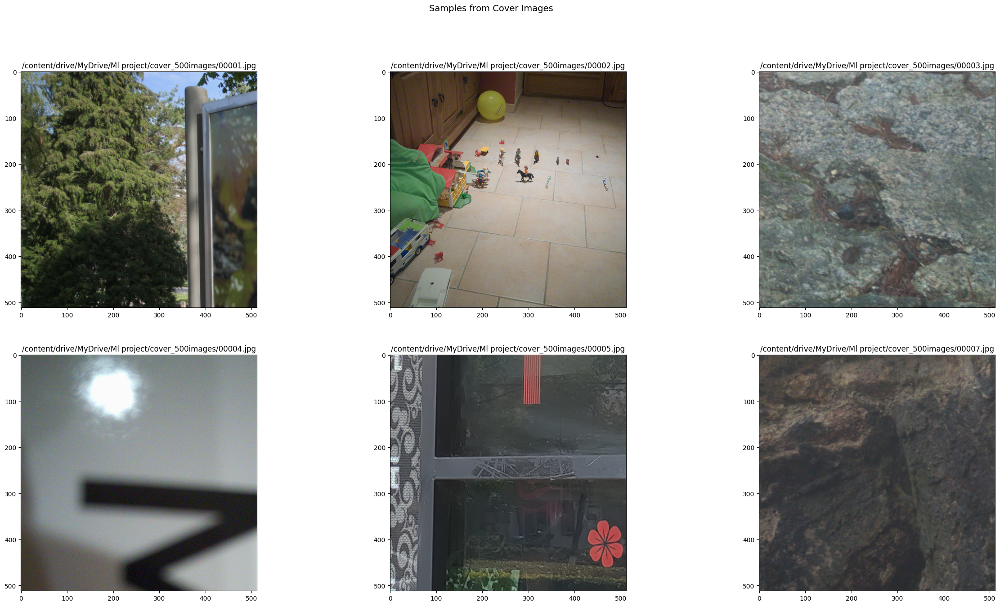

In [ ]:
#VISUALIZING SOME IMAGES FROM COVER SECTION
fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(30, 15))
k=0
for i, row in enumerate(ax):
    for j, col in enumerate(row):
        img = sk.imread(cover_images_path[k])
        col.imshow(img)
        col.set_title(cover_images_path[k])
        k=k+1
plt.suptitle('Samples from Cover Images', fontsize=14)
plt.show()

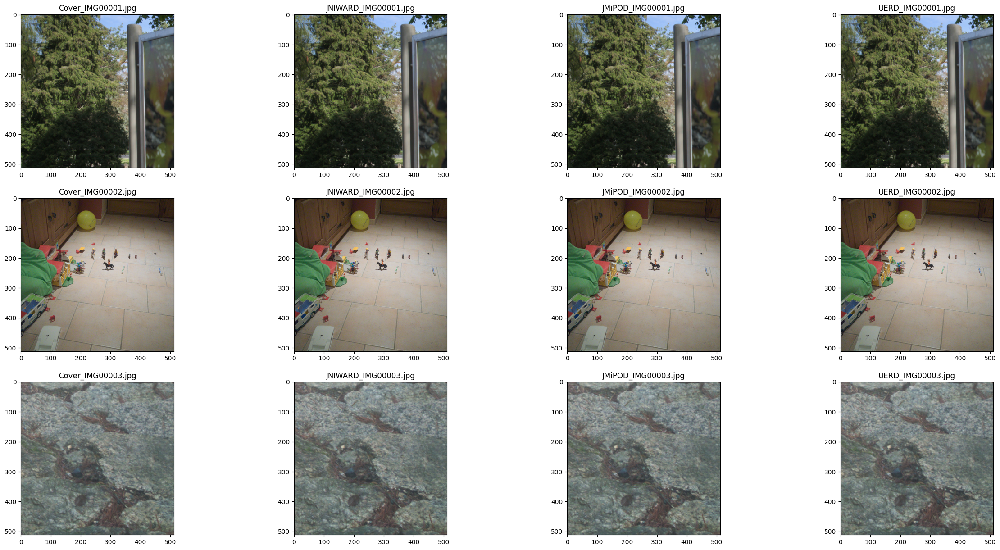

In [ ]:
#Visualizing Cover and Encoded side by side

fig, ax = plt.subplots(nrows=3, ncols=4, figsize=(30, 15))
for i in range(3):
    '''
    If you want to print more images just change the values in range and ncols in subplot

    '''
    coverimg = sk.imread(cover_images_path[i])
    juniwardimg = sk.imread(JUNIWARD_images_path[i])
    jmipodimg = sk.imread(JMIPOD_images_path[i])
    uerdimg = sk.imread(UERD_images_path[i])

    ax[i,0].imshow(coverimg)
    ax[i,0].set_title('Cover_IMG'+train_imageids[i])
    ax[i,1].imshow(juniwardimg)
    ax[i,1].set_title('JNIWARD_IMG'+train_imageids[i])
    ax[i,2].imshow(jmipodimg)
    ax[i,2].set_title('JMiPOD_IMG'+train_imageids[i])
    ax[i,3].imshow(uerdimg)
    ax[i,3].set_title('UERD_IMG'+train_imageids[i])

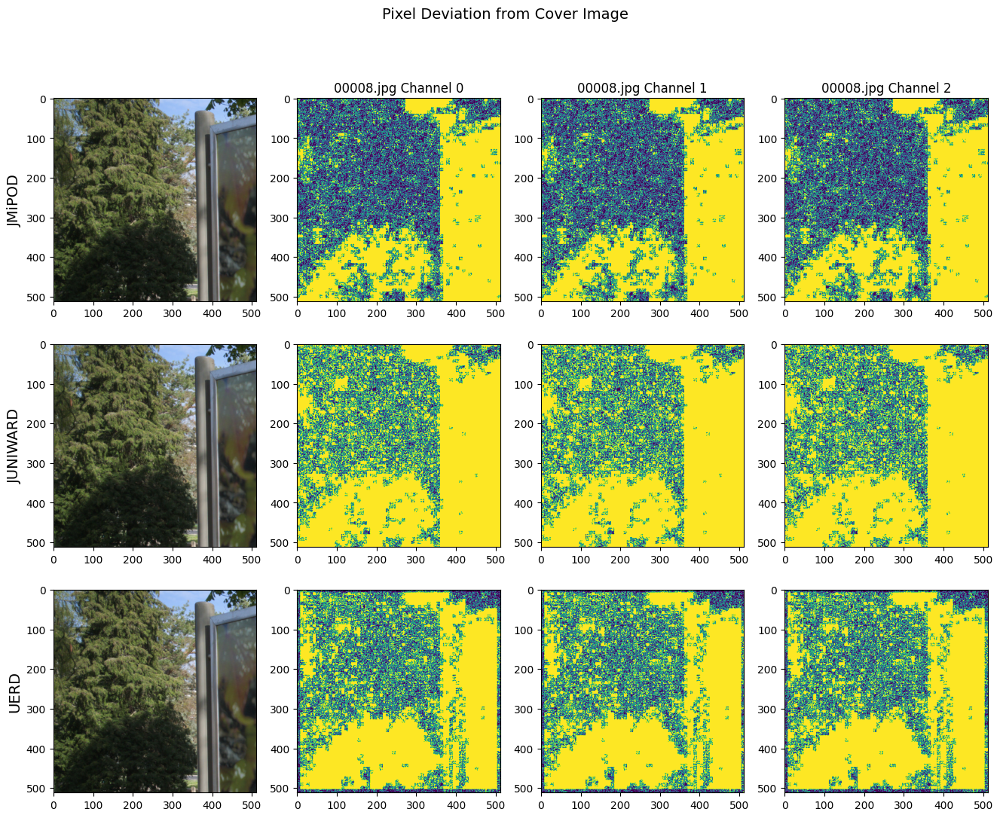

In [ ]:
#As expected we can't see any difference with naked eye ,We know that information is hidden in somewhere using distortion function

img_cover = sk.imread(cover_images_path[0])
img_jmipod = sk.imread(JMIPOD_images_path[0])
img_juniward = sk.imread(JUNIWARD_images_path[0])
img_uerd = sk.imread(UERD_images_path[0])


fig, ax = plt.subplots(nrows=3, ncols=4, figsize=(16, 12))
ax[0,0].imshow(img_jmipod)
ax[0,1].imshow((img_cover == img_jmipod).astype(int)[:,:,0])
ax[0,1].set_title(f'{train_imageids[k]} Channel 0')

ax[0,2].imshow((img_cover == img_jmipod).astype(int)[:,:,1])
ax[0,2].set_title(f'{train_imageids[k]} Channel 1')
ax[0,3].imshow((img_cover == img_jmipod).astype(int)[:,:,2])
ax[0,3].set_title(f'{train_imageids[k]} Channel 2')
ax[0,0].set_ylabel('JMiPOD', rotation=90, fontsize=14)


ax[1,0].imshow(img_juniward)
ax[1,1].imshow((img_cover == img_juniward).astype(int)[:,:,0])
ax[1,2].imshow((img_cover == img_juniward).astype(int)[:,:,1])
ax[1,3].imshow((img_cover == img_juniward).astype(int)[:,:,2])
ax[1,0].set_ylabel('JUNIWARD', rotation=90, fontsize=14)

ax[2,0].imshow(img_uerd)
ax[2,1].imshow((img_cover == img_uerd).astype(int)[:,:,0])
ax[2,2].imshow((img_cover == img_uerd).astype(int)[:,:,1])
ax[2,3].imshow((img_cover == img_uerd).astype(int)[:,:,2])
ax[2,0].set_ylabel('UERD', rotation=90, fontsize=14)

plt.suptitle('Pixel Deviation from Cover Image', fontsize=14)

plt.show()

* So Again, on doing these visualizations , the organizers again made the point that comparing the pixel values of RGB channels of normal and stego images is not exactly right. https://www.kaggle.com/c/alaska2-image-steganalysis/discussion/147494 --->

To understand everything we will have to dive deeper into the underlying principles of JPEG and Stregnography

* Firstly the image is converted into YCbCr from RGB channels. YCbCr and RGB are both colorspaces having different channels where YCbCr consists three channels as Luminance(Y) , Cb(Cb is blue minus luma (B-Y)) , Cr(Cr is red minus luma (R-Y)).

* Then DCT is applied on the pixels of these channels , using DCT coeff.

* The image encoded using JPEG algorithm stays in YCbCr colorspace untill it is decoded by an Image viewer software. When a JPEG is read it is decoded and converted back to RGB colorspace to be rendered on screen using the techniques.
![jpg formation](https://drive.google.com/uc?export=view?&id=1vyP_bw9MokfYiyLa7gOiF8XOVyNZaQkZ)

## **Stenography : Complete Understanding**
Now that we know how JPEG works , let's understand how stegnography works and how techniques used have evolved over the years.

### **So what do you think can be the potential hiding spots of information in a JPEG File ?**

* **Channels of the respective color Spaces like RGB and YCbCr.**
These were the techniques used in the starting algorithms but as we have seen it is easily recognizeable even using knaive approach , so people started to find a new technique for hiding information

* **DCT coeffs of different channels**
The more newer approaches hides information in the DCT coeffs of different channels of JPEG image and that too the payload(secret data) is randomly distributed among them taking into the statistics of DCT coeffs
After watching this video you will have a clear understanding of everything that has been discussed uptill and now.



# **New and Improved Approach**
So now we have got to approache for model building :-

### * **Use pixels as input of our neural nets as we were doing uptill now and we can also use naive method**

###                 **or**

### * **Use DCT coeff's instead of pixel values as an input to our neural networks for prediction of labels**

# **Let's see how we can visualize different Channels of a YCbCr colorspace Image**

**What are YCbCr channels?**

The Y channel expresses the intensity of light in an image. This channel is more sensitive to the human eye and therefore is more prominent than the Cb and Cr channels.

Cb channel shows the blue component relative to green component and the Cr channel shows the red component relative to blue component.

The idea here is to compress our original image in such a way that the difference is insignificant to the viewer.




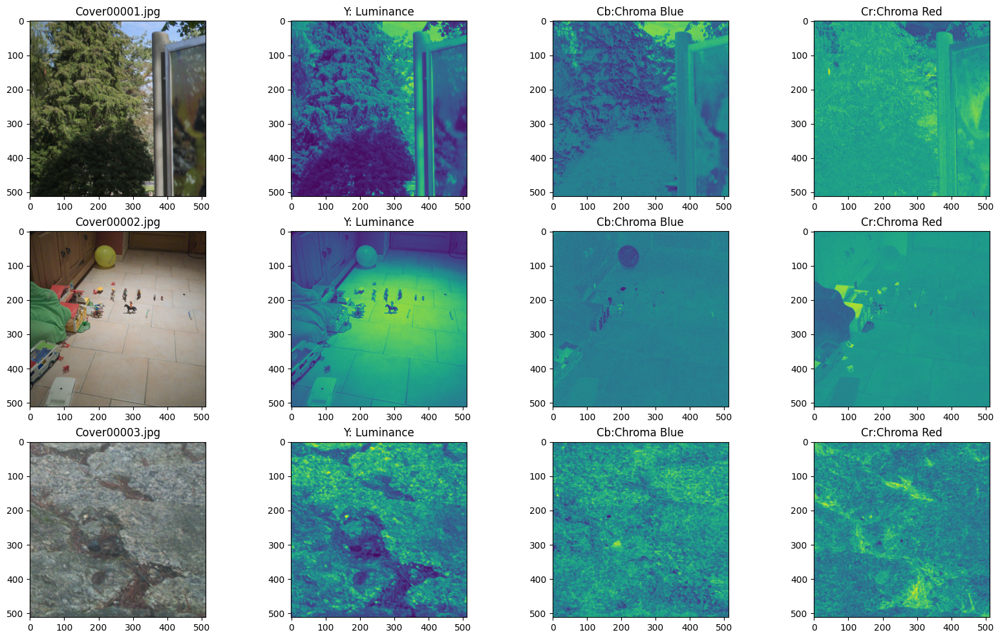

In [ ]:
# Let's see how we can visualize different Channels of a YCbCr colorspace Image
fig,ax = plt.subplots(3,4,figsize=(20,12))

for i,paths in enumerate(cover_images_path[:3]):
    image = Image.open(paths)
    ycbcr = image.convert('YCbCr')
    (y, cb, cr) = ycbcr.split()

    ax[i,0].imshow(image)
    ax[i,0].set_title('Cover'+train_imageids[i])
    ax[i,1].imshow(y)
    ax[i,1].set_title('Y:

    Luminance')
    ax[i,2].imshow(cb)
    ax[i,2].set_title('Cb:Chroma Blue')
    ax[i,3].imshow(cr)
    ax[i,3].set_title('Cr:Chroma Red')

## **Let's plot our cover images with these channels side by side and observe the differences.**

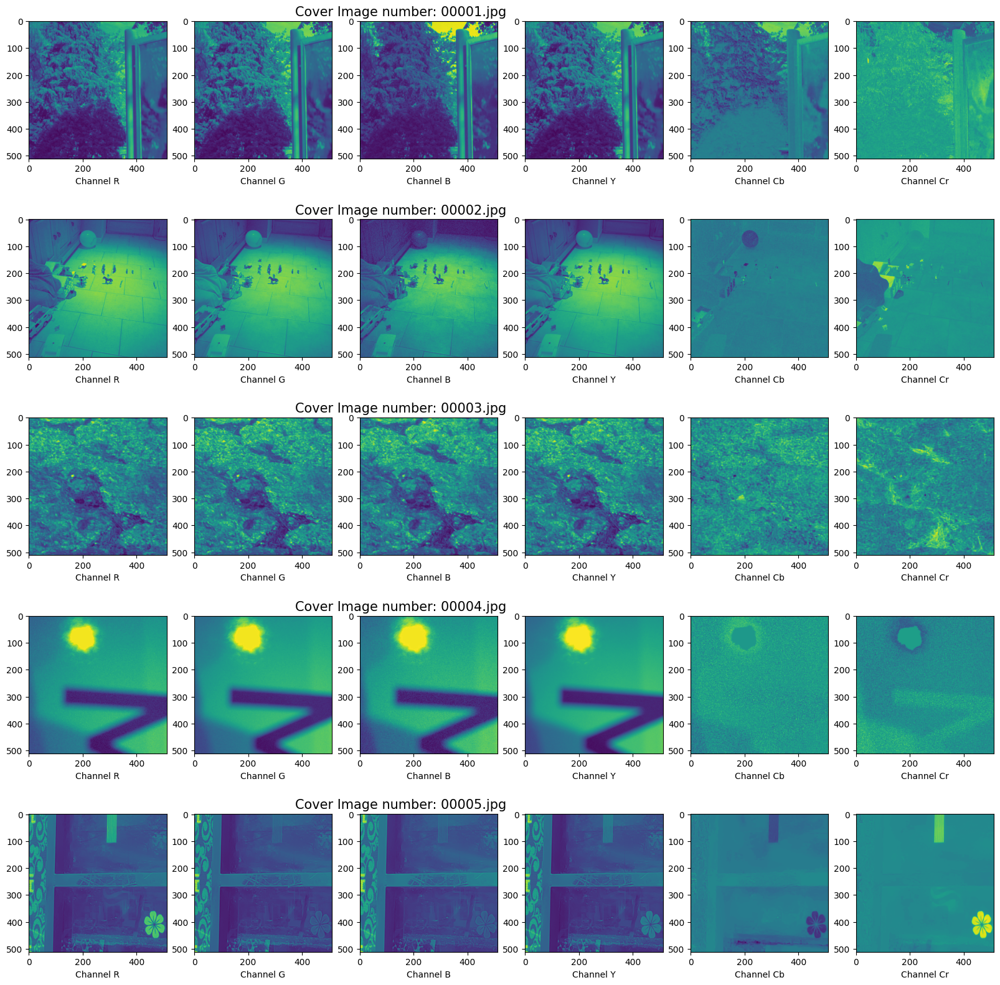

In [ ]:
# visualize different Channels of a YCbCr colorspace Image

def YCbCr_channel(image_paths, title):
    fig, axes = plt.subplots(ncols=6, nrows=len(image_paths), figsize=(20, 20))

    for i, img_path in enumerate(image_paths):
        im = Image.open(img_path)
        im_ycbcr = im.convert('YCbCr')
        y, cb, cr = im_ycbcr.split()
        r, g, b = im.split()

        axes[i][0].imshow(r)
        axes[i][0].set_xlabel("Channel R")
        axes[i][1].imshow(g)
        axes[i][1].set_xlabel("Channel G")
        axes[i][2].imshow(b)
        axes[i][2].set_xlabel("Channel B")
        axes[i][3].imshow(y)
        axes[i][3].set_xlabel("Channel Y")
        axes[i][4].imshow(cb)
        axes[i][4].set_xlabel("Channel Cb")
        axes[i][5].imshow(cr)
        axes[i][5].set_xlabel("Channel Cr")

    for ax, row in zip(axes[:,0], image_paths):
        ax.set_title(title.format(row.split("/")[-1]), size=15, x=2.7, y=1.)

# Example usage
image_paths = cover_images_path[:5]  # Assuming you have a list of image paths
YCbCr_channel(image_paths, title="Cover Image number: {}")


## **Now let's explore the Different channels of YCbCr of Cover and Encoded Image side by side.**

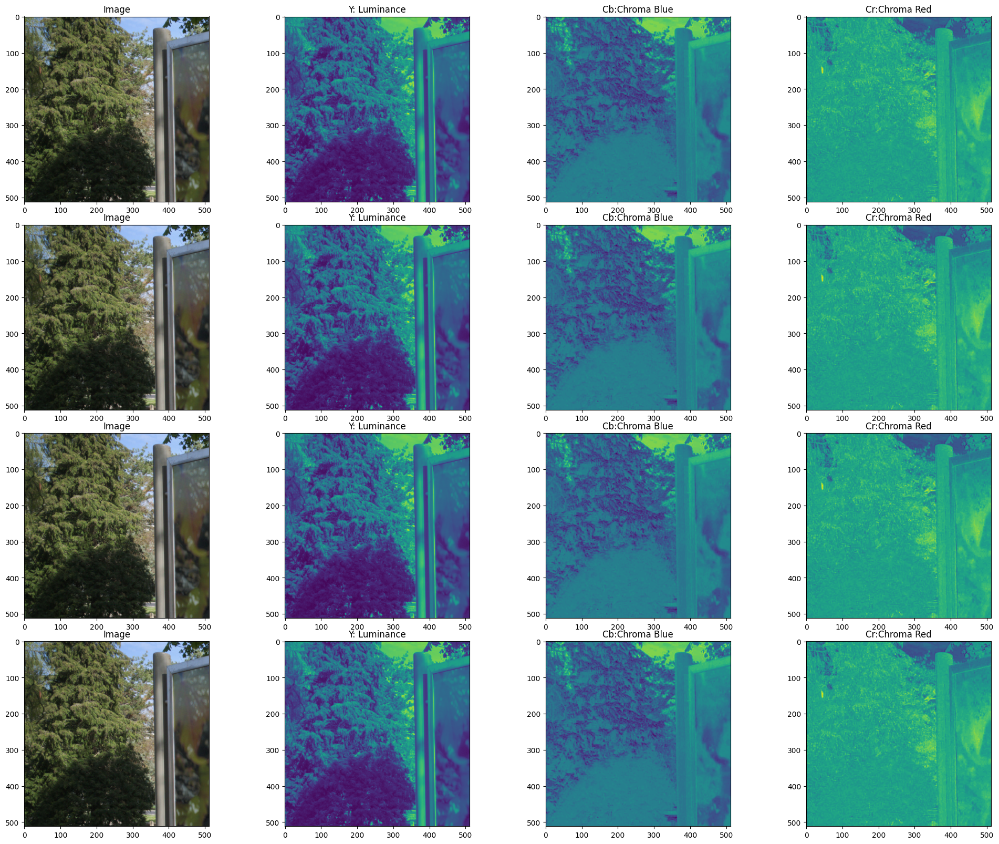

In [ ]:
#Now let's explore the Different channels of YCbCr of Cover and Encoded Image side by side.
fig,ax = plt.subplots(4,4,figsize=(20,16))
plt.tight_layout()


im1 = Image.open(cover_images_path[0])
im2 = Image.open(JUNIWARD_images_path[0])
im3 = Image.open(JMIPOD_images_path[0])
im4 = Image.open(UERD_images_path[0])

for i,image in enumerate([im1,im2,im3,im4]):
    ycbcr = image.convert('YCbCr')
    (y, cb, cr) = ycbcr.split()

    ax[i,0].imshow(image)
    ax[i,0].set_title('Image')
    ax[i,1].imshow(y)
    ax[i,1].set_title('Y: Luminance')
    ax[i,2].imshow(cb)
    ax[i,2].set_title('Cb:Chroma Blue')
    ax[i,3].imshow(cr)
    ax[i,3].set_title('Cr:Chroma Red')

### We know how an Image is compressed using JPEG and how DCT coeffs are calculated using Quantization and Encoding. Now we can go deeper and analyze for which model would be better .
## **We will start now by getting the DCT coeffs of images and visualizing them**

In [ ]:
! git clone https://github.com/dwgoon/jpegio

Cloning into 'jpegio'...
remote: Enumerating objects: 1408, done.
remote: Counting objects: 100% (254/254), done.
remote: Compressing objects: 100% (141/141), done.
remote: Total 1408 (delta 124), reused 212 (delta 101), pack-reused 1154
Receiving objects: 100% (1408/1408), 231.74 MiB | 12.74 MiB/s, done.
Resolving deltas: 100% (699/699), done.
Updating files: 100% (381/381), done.


In [ ]:
!pip install jpegio/.
import jpegio as jio

Processing ./jpegio
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for jpegio: filename=jpegio-0.2.4-cp310-cp310-linux_x86_64.whl size=1235249 sha256=da84768f1e7b5fcefce615381c5f11ebecdcb48ac0123701a65c55cc01f7ab0d
  Stored in directory: /tmp/pip-ephem-wheel-cache-721428wj/wheels/29/84/8a/af6f9160ad19d4668ed2709834f02da44ce3cce73a30a2c903
Successfully built jpegio


## **Let's plot DCT coeffs of Cover and Encoded Image and try to see if there is any difference.**
## The attribute coeff_arrays gives the DCT coeffs of all the three channels of YCbCr of the images.

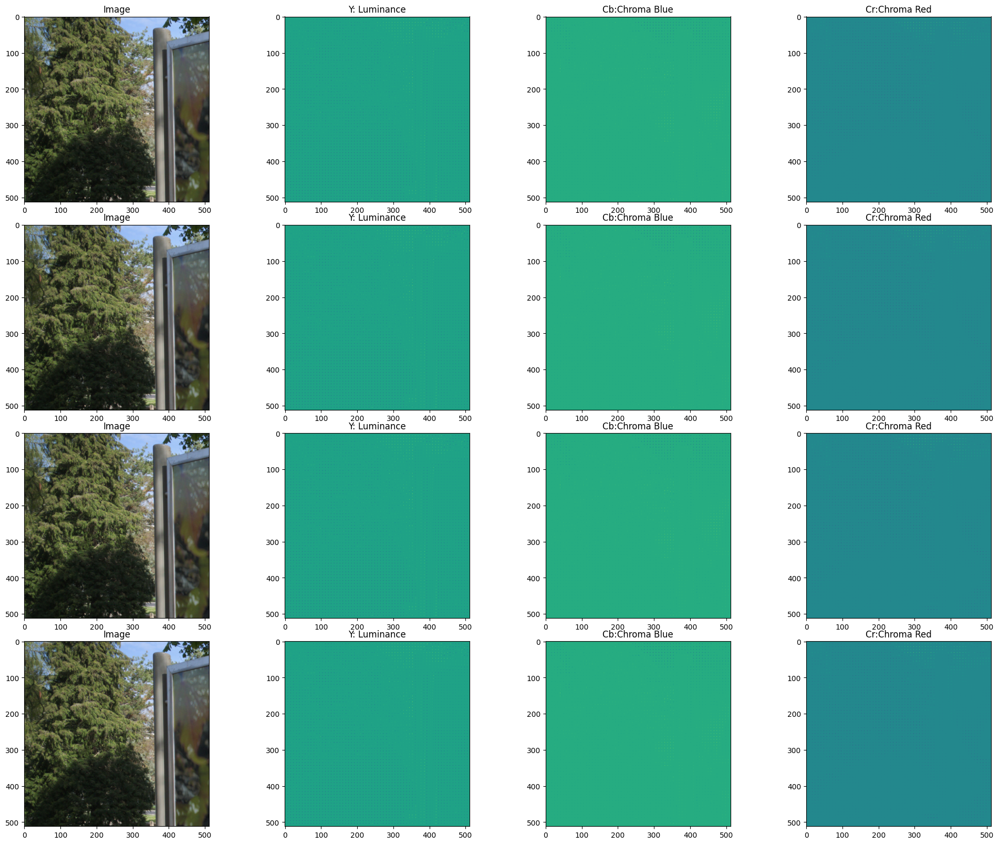

In [ ]:


fig,ax = plt.subplots(4,4,figsize=(20,16))
plt.tight_layout()

for i,path in enumerate([cover_images_path[0],JUNIWARD_images_path[0],JMIPOD_images_path[0],UERD_images_path[0]]):

    image = Image.open(path)
    jpeg = jio.read(path)
    DCT_Y = jpeg.coef_arrays[0]
    DCT_Cr = jpeg.coef_arrays[1]
    DCT_Cb = jpeg.coef_arrays[2]


    ax[i,0].imshow(image)
    ax[i,0].set_title('Image')
    ax[i,1].imshow(DCT_Y)
    ax[i,1].set_title('Y: Luminance')
    ax[i,2].imshow(DCT_Cb)
    ax[i,2].set_title('Cb:Chroma Blue')
    ax[i,3].imshow(DCT_Cr)
    ax[i,3].set_title('Cr:Chroma Red')

## Up untill now we were using difference in pixel values and normal pixel values for analysis and it has been argued that's it is not the right way.  **Lets now look at difference in DCT values and difference in pixels and see the differences, this will help us to make better decision**

In [ ]:
# Initializing arrays to store DCT coefficients of cover and stego images
coverDCT = np.zeros([512, 512, 3])
stegoDCT = np.zeros([512, 512, 3])

# Reading the first cover image and first stego image
jpeg = jio.read(cover_images_path[0])
stego_juni = jio.read(JUNIWARD_images_path[0])


## **Difference in DCT values**

Total number of non-zero differences in DCT coefficients: 5883
Unique DCT differences: [-1.  0.  1.]


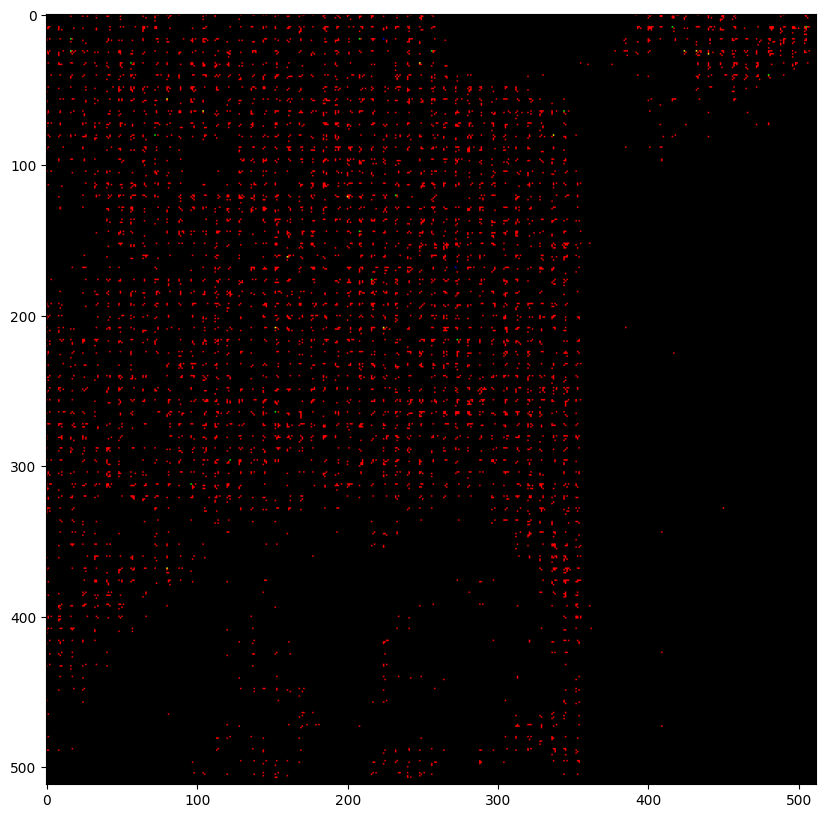

In [ ]:

# Assigning DCT coefficients of the cover image and stego image to coverDCT array for each color channel(red,green, blue)
coverDCT[:,:,0] = jpeg.coef_arrays[0]
coverDCT[:,:,1] = jpeg.coef_arrays[1]
coverDCT[:,:,2] = jpeg.coef_arrays[2]

stegoDCT[:,:,0] = stego_juni.coef_arrays[0] ; stegoDCT[:,:,1] = stego_juni.coef_arrays[1] ; stegoDCT[:,:,2] = stego_juni.coef_arrays[2]

# Calculating the difference in DCT coefficients between cover and stego images
DCT_diff = coverDCT - stegoDCT

# So since they are not the same Images the DCT_diff would not be zero
# Counting the number of non-zero differences in DCT coefficients
non_zero_diff_count = len(DCT_diff[np.where(DCT_diff != 0)])
print("Total number of non-zero differences in DCT coefficients:", non_zero_diff_count)


# Printing the unique values of DCT differences
unique_diff_values = np.unique(DCT_diff)
print("Unique DCT differences:", unique_diff_values)

# Plotting the absolute values of DCT differences for visualization
plt.figure(figsize=(16,10))
plt.imshow(abs(DCT_diff))
plt.show()

## **Difference in Pixel values**

161126
[-4. -3. -2. -1.  0.  1.  2.  3.  4.  5.]


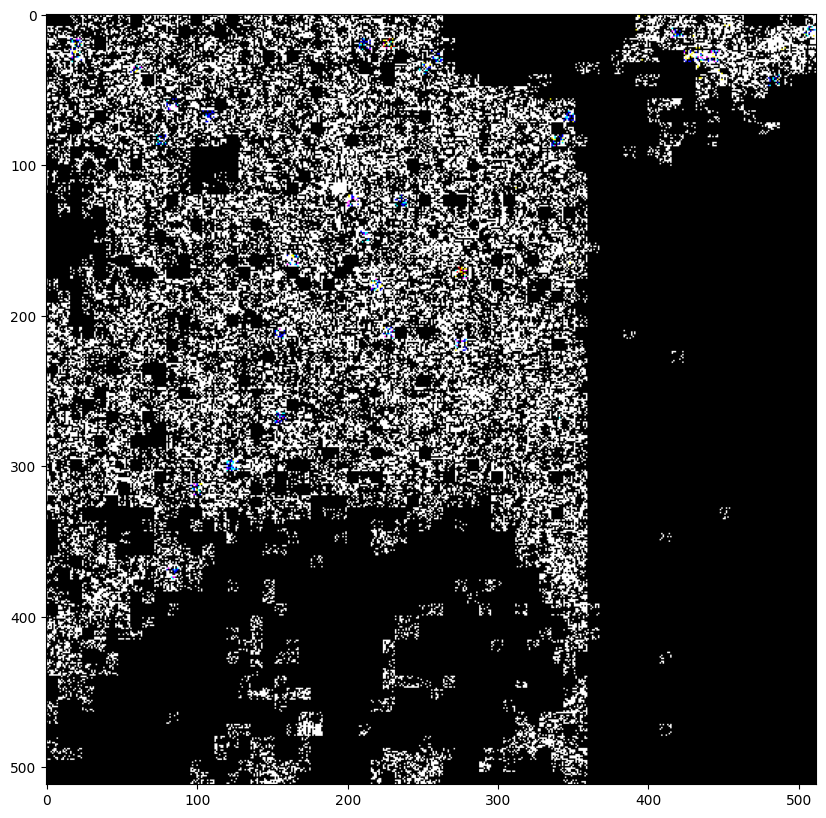

In [ ]:
coverPixels = np.array(Image.open(cover_images_path[0])).astype('float')
stegoPixels = np.array(Image.open(JUNIWARD_images_path[0])).astype('float')

pixelsDiff = coverPixels - stegoPixels

# So since they are not the same Images the pixels_diff would not be zero
print(len(pixelsDiff[np.where(pixelsDiff!=0)]))
print(np.unique(pixelsDiff))
plt.figure(figsize=(16,10))
plt.imshow( abs(pixelsDiff) )
plt.show()

### * From the images it is hard to conclude which one works better, as images of both DCT and Pixel pattern give us the same underlying pattern. But one can argue that pixel values contain a lot of noise whereas DCT values do not and can get you a better model

### * **But from the number of non-zero difference values of both DCT and pixels we can see that Pixels have more non-zero values t**han DCT and hence are more distintive for differentiation between cover and stego images

### **Let's also look the images side by side to get a better understanding.**

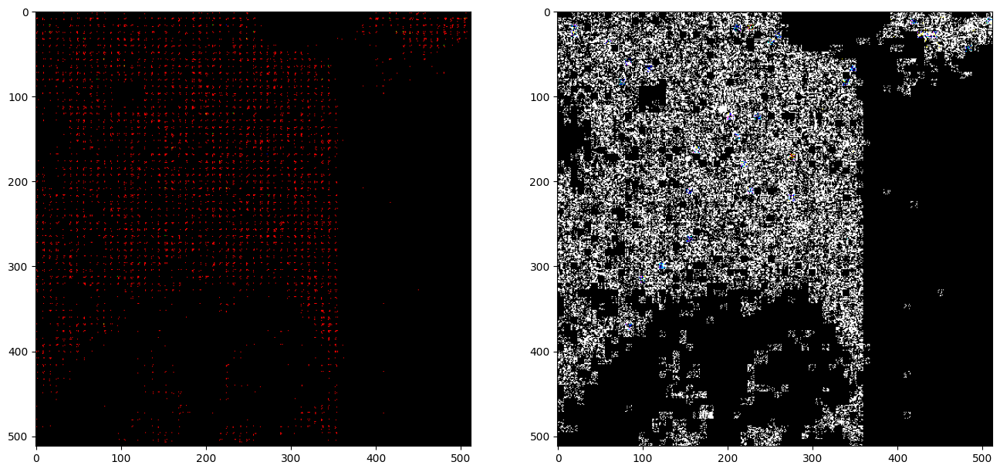

In [ ]:
fig,ax = plt.subplots(1,2,figsize=(16,12))
ax[0].imshow(abs(DCT_diff))
ax[1].imshow(abs(pixelsDiff))

## **Computing cosine dissimilarity between the pixel values of a cover image and encoded images using different algorithms (JMiPOD, JUNIWARD, UERD).**

In [ ]:
final = []  # Initialize the final list before the loop

# Define a function to create labels for regression based on cosine dissimilarity
def create_labels(cover, jmipod, juniward, uerd, image_id):
    # Read images using scikit-image
    image = sk.imread(cover)
    jmipodimg = sk.imread(jmipod)
    juniward = sk.imread(juniward)
    uerd = sk.imread(uerd)

    # Flatten the pixel values of each image into vectors
    vec1 = np.reshape(image, (512*512*3))
    vec2 = np.reshape(jmipodimg, (512*512*3))
    vec3 = np.reshape(juniward, (512*512*3))
    vec4 = np.reshape(uerd, (512*512*3))

    # Compute cosine dissimilarity between cover and encoded images
    cos1 = spatial.distance.cosine(vec1, vec2)
    cos2 = spatial.distance.cosine(vec1, vec3)
    cos3 = spatial.distance.cosine(vec1, vec4)

    # Append computed dissimilarities and corresponding image IDs to a list
    final.append({'image_id': image_id, 'jmipod': cos1, 'juniward': cos2, 'uerd': cos3})


In [ ]:


# Iterate over the range of the total number of images available in the dataset
for k in tqdm(range(len(cover_images_path))):
    # Use the paths of all images instead of only the first 30,000
    create_labels(cover_images_path[k], JMIPOD_images_path[k], JUNIWARD_images_path[k], UERD_images_path[k], train_imageids[k])


100%|██████████| 500/500 [04:48<00:00,  1.73it/s]


In [ ]:
# Create a Pandas DataFrame named train_temp from the list of dictionaries stored in the final list,
# where each dictionary contains image IDs and their corresponding dissimilarities computed in the create_labels function
# Display the first few rows of the DataFrame train_temp to preview the data

train_temp = pd.DataFrame(final)
train_temp.head()

,image_id,jmipod,juniward,uerd
0,00001.jpg,0.072243,0.043359,0.055192
1,00002.jpg,0.046728,0.105261,0.091785
2,00003.jpg,0.067416,0.025235,0.021030
3,00004.jpg,0.115326,0.118881,0.115003
4,00005.jpg,0.005886,0.004440,0.003662


## **The model preprocesses image data, calculates cosine dissimilarity-based labels, and trains a CNN architecture for regression, predicting the probability of images containing hidden information. It utilizes convolutional layers for feature extraction and dense layers for regression, treating the task as a continuous probability estimation problem.**

### **Adding softmax to our dissimilarity to get Probabilities**

In [ ]:
def sigmoid(X):
   return 1/(1+np.exp(-X))

In [ ]:
train_temp['jmipod'] = train_temp['jmipod'].apply(lambda x:sigmoid(x))
train_temp['juniward'] = train_temp['juniward'].apply(lambda x:sigmoid(x))
train_temp['uerd'] = train_temp['uerd'].apply(lambda x:sigmoid(x))

In [ ]:
train_temp.head()

,image_id,jmipod,juniward,uerd
0,00001.jpg,0.518053,0.510838,0.513794
1,00002.jpg,0.511680,0.526291,0.522930
2,00003.jpg,0.516848,0.506308,0.505257
3,00004.jpg,0.528800,0.529685,0.528719
4,00005.jpg,0.501471,0.501110,0.500915


In [ ]:
#preparing the training data by loading images from different image paths (cover, JMIPOD, JUNIWARD, and UERD) and their corresponding labels
IMG_SIZE = 300
def load_training_data():
  train_data = []
  data_paths = [cover_images_path,JUNIWARD_images_path,JMIPOD_images_path,UERD_images_path]
  labels = [np.zeros(train_temp.shape[0]),train_temp['juniward'],train_temp['jmipod'],train_temp['uerd']]
  for i,image_path in enumerate(data_paths):
    for j,img in enumerate(image_path[:10000]): #limit the iteration to the first 10,000 elements of the image_path list
        label = labels[i][j]
        img = Image.open(img)
        img = img.convert('L')
        img = img.resize((IMG_SIZE, IMG_SIZE), Image.LANCZOS)
        train_data.append([np.array(img), label])

  shuffle(train_data)
  return train_data

In [ ]:
#loading the test data
# Define a function to load test data
def load_test_data():
    test_data = []
    # Iterate through the paths of test images
    for img in test_images_path:
        # Open the image using PIL
        img = Image.open(img)
        # Convert the image to grayscale
        img = img.convert('L')
        # Resize the image to a specified size using lancxos resampling
        img = img.resize((IMG_SIZE, IMG_SIZE), Image.LANCZOS)
        # Append the processed image data to the test data list
        test_data.append([np.array(img)])

    return test_data


In [ ]:
import pandas as pd
import os
import skimage.io as sk
import matplotlib.pyplot as plt
from scipy import spatial
from tqdm import tqdm
from PIL import Image
from random import shuffle

In [ ]:
%%time
train = load_training_data()

CPU times: user 16.3 s, sys: 885 ms, total: 17.2 s
Wall time: 25.8 s


### **Sanity Check**

In [ ]:
len(train)

2000

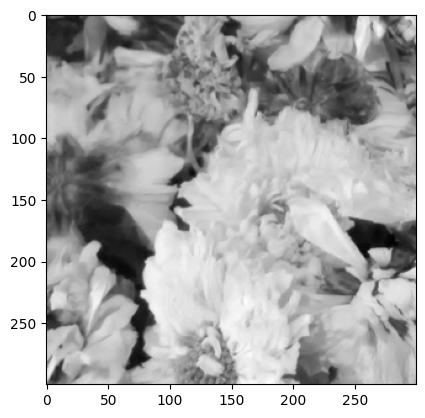

In [ ]:
## Display the 116th image from the training dataset in grayscale
plt.imshow(train[115][0], cmap = 'gist_gray')

In [ ]:
## Extract and reshape the images from the training dataset for CNN input
trainImages = np.array([i[0] for i in train]).reshape(-1, IMG_SIZE, IMG_SIZE, 1)
# Extract the labels from the training dataset
trainLabels = np.array([i[1] for i in train])

# **Model: using 5 Conv2D layers with max pooling and batch norm for baseline**

In [ ]:
#PRELIMINARIES
import keras
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import BatchNormalization


**Using TensorFlow backend.**

# Define CNN model architecture using Keras Sequential API with convolutional layers, max-pooling layers, batch normalization, dropout, and dense layers


In [ ]:
model = Sequential()
model.add(Conv2D(32, kernel_size = (3, 3), activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, 1)))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization())
model.add(Conv2D(64, kernel_size=(3,3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization())
model.add(Conv2D(64, kernel_size=(3,3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization())
model.add(Conv2D(96, kernel_size=(3,3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization())
model.add(Conv2D(32, kernel_size=(3,3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2,2)))
model.add(BatchNormalization())
model.add(Dropout(0.2))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(1))

## **Using mean squared error (MSE) loss and the Adam optimizer in a CNN model complining.**

### This is a  regression-based approach, as MSE is commonly used for regression tasks to minimize the squared difference between predicted and actual values, and Adam optimizes the model's weights to reduce this loss efficiently.

In [ ]:
model.compile(loss='mean_squared_error', optimizer='adam',metrics = ['mean_squared_error'])

In [ ]:
print(model.summary())

## Feeding training data into the model using model.fit() with specified batch size and epochs


In [ ]:
model.fit(trainImages, trainLabels, batch_size = 100, epochs = 5, verbose = 1)

Epoch 1/5
20/20 [==============================] - 405s 20s/step - loss: 2.5899 - mean_squared_error: 2.5899
Epoch 2/5
20/20 [==============================] - 395s 20s/step - loss: 1.2916 - mean_squared_error: 1.2916
Epoch 3/5
20/20 [==============================] - 384s 19s/step - loss: 0.5844 - mean_squared_error: 0.5844
Epoch 4/5
20/20 [==============================] - 376s 19s/step - loss: 0.4730 - mean_squared_error: 0.4730
Epoch 5/5
20/20 [==============================] - 382s 19s/step - loss: 0.3356 - mean_squared_error: 0.3356


## Inference on the test data using the trained model.
Make predictions on test data and save predictions to 'submission.csv'


In [ ]:
#preprocesses the test images

%%time
test = load_test_data()
testImages = np.array([i[0] for i in test]).reshape(-1, IMG_SIZE, IMG_SIZE, 1)


CPU times: user 4.53 s, sys: 338 ms, total: 4.87 s
Wall time: 2min 14s


## Use the preprocessed test data for predictions

In [ ]:
%%time
predict = model.predict(testImages,batch_size=100)

5/5 [==============================] - 41s 8s/step
CPU times: user 36.4 s, sys: 20.2 s, total: 56.6 s
Wall time: 1min 22s


## Update the submission DataFrame with the predictions

In [ ]:
ss['Label'] = predict

NameError: name 'ss' is not defined

In [ ]:
# Save the submission DataFrame to a CSV file
ss.to_csv('submission.csv',index=False)
train_temp.to_csv('train.csv',index=False)

In [ ]:
train_temp.to_csv('train.csv',index=False)

In [ ]:
import seaborn as sns

# Load the train data
train_data = pd.read_csv('train.csv')

# Plot regression plot for each column against the image_id
sns.pairplot(train_data, x_vars=['jmipod', 'juniward', 'uerd'], y_vars='image_id', kind='reg', height=5)
plt.show()


I have used only top 44,000 images because if I run on more than that it exceeds memory allocation

Now that we have a data loader , we can now load the data and check if everything is working.

In this model, regression and CNN (Convolutional Neural Network) work together as follows:

Feature Extraction with CNN: The CNN architecture is used to extract meaningful features from the input images. The convolutional layers learn hierarchical representations of the image data, capturing patterns and features at different levels of abstraction. This process enables the model to automatically identify relevant features for distinguishing between images with and without hidden information.

Regression for Prediction: Once the features are extracted by the CNN layers, the flattened feature maps are passed through dense layers for regression. The regression task involves learning a mapping from the extracted features to continuous output values, representing the probability that an image contains hidden information. The model is trained to minimize the mean squared error loss between the predicted probabilities and the ground truth labels.

Training and Inference: During training, the model iteratively adjusts its parameters (weights and biases) using gradient descent to minimize the prediction error. Once trained, the model can make predictions on new unseen images by passing them through the CNN layers for feature extraction and then through the regression layers to obtain the predicted probabilities.

Overall, the CNN serves as a feature extractor, while the regression layers enable the model to learn the relationship between the extracted features and the target output, allowing it to predict the presence of hidden information in images.



Data Preparation: Training data is loaded, consisting of cover images and images encoded using different algorithms (JMIPOD, JUNIWARD, UERD). Labels are created based on the cosine dissimilarity between cover and encoded images.

Model Architecture: A CNN architecture is defined, comprising convolutional layers for feature extraction, followed by dense layers for regression.

Regression Task: The model is trained to predict the probability of images containing hidden information, treating it as a regression problem.

Training: The model is trained using the training data, optimizing parameters to minimize mean squared error loss.

Inference: Trained model makes predictions on test data, providing probabilities of images containing hidden information.

Output: Predictions are saved to a CSV file for submission, and training data with labels is saved for further analysis.
Overall, the model uses a CNN for feature extraction and regression for predicting the presence of hidden information in images, treating it as a continuous probability estimation problem.